# Data Preprocessing & Imports

## Imports & Missing Values

In [ ]:
!pip install catboost
!pip install git+https://github.com/tensorflow/docs
!pip install tensorflow_decision_forests

In [ ]:
import pandas as pd
import numpy as np
import string
import math
import seaborn as sns
import matplotlib.pyplot as plt
import lightgbm as lgb
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials
import xgboost as xgb
import tensorflow as tf
import tensorflow_docs as tfdocs
import tensorflow_docs.modeling
import tensorflow_decision_forests as tfdf
import warnings

from catboost import CatBoostClassifier, Pool, metrics
from tensorboard.plugins.hparams import api as hparam
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, cross_val_score, StratifiedShuffleSplit
from sklearn.impute import KNNImputer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, OrdinalEncoder, LabelEncoder, StandardScaler, PowerTransformer
from sklearn.utils.class_weight import compute_class_weight
from sklearn.compose import ColumnTransformer
from sklearn.feature_selection import RFECV, SelectKBest, RFE
from sklearn.svm import SVR, SVC
from sklearn.linear_model import LogisticRegression
from scipy.stats import norm, skew
from scipy.special import boxcox1p
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score, accuracy_score, f1_score, precision_recall_curve, auc, precision_recall_curve, plot_precision_recall_curve, recall_score, precision_score, confusion_matrix, balanced_accuracy_score, average_precision_score, plot_confusion_matrix
from imblearn.over_sampling import SMOTE, RandomOverSampler, BorderlineSMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from sklearn.decomposition import PCA

In [ ]:
! git clone --recursive https://github.com/Microsoft/LightGBM

In [ ]:
! cd LightGBM && rm -rf build && mkdir build && cd build && cmake -DUSE_GPU=1 ../../LightGBM && make -j4 && cd ../python-package && python3 setup.py install --precompile --gpu;   

In [5]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/creditcard.csv')

In [6]:
imputer = KNNImputer(n_neighbors=5)
df = pd.DataFrame(imputer.fit_transform(df), columns = df.columns)

## **Outlier Detection**

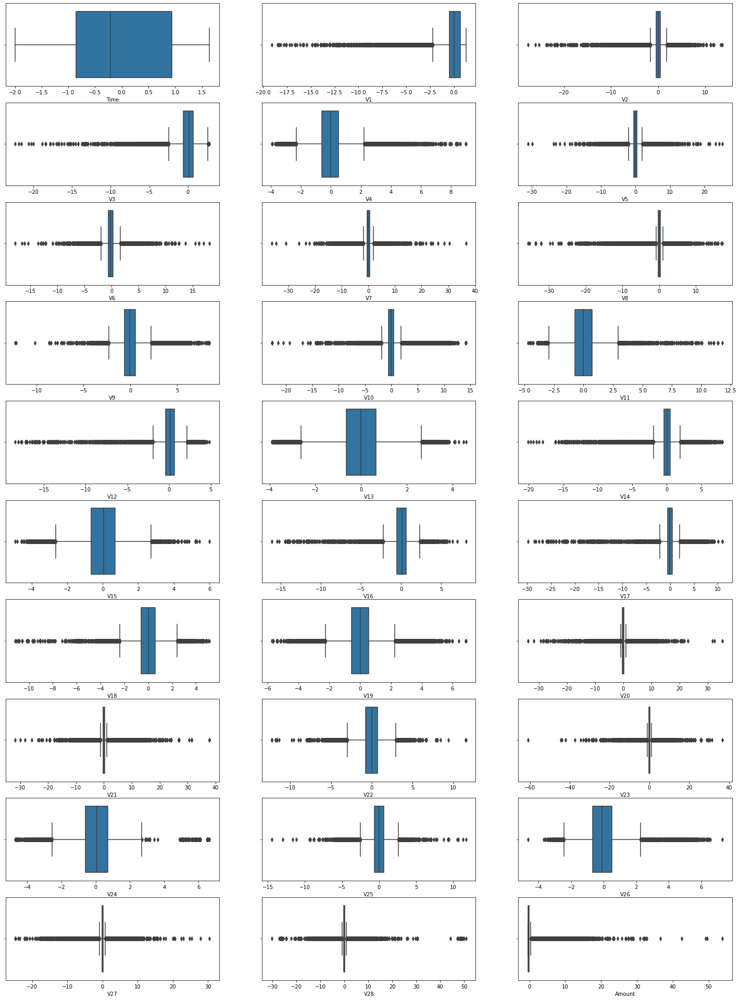

In [ ]:
num_cols = X_train._get_numeric_data().columns 

plt.figure(figsize = (25,45))
for i in enumerate(num_cols):
  plt.subplot(13,3,i[0]+1)
  sns.boxplot(x=X_train[i[1]])
  plt.xlabel(i[1])

In [7]:
# Removing outliers
df = df[df['V1'] > -40]
df = df[df['V2'] > -45]
df = df[df['V3'] < 5]
df = df[df['V4'] < 14]
df = df[df['V5'] > -60]
df = df[df['V6'] < 40]
df = df[df['V7'] < 50]
df = df[df['V8'] > -46]
df = df[df['V9'] < 10]
df = df[df['V10'] < 16]
df = df[df['V12'] < 6]
df = df[df['V13'] < 6]
df = df[df['V13'] > -5]
df = df[df['V14'] < 9]
df = df[df['V15'] < 8]
df = df[df['V16'] < 10]
df = df[df['V19'] > -6]
df = df[df['V20'] > -40]
df = df[df['V20'] < 34]
df = df[df['V21'] > -31]
df = df[df['V22'] < 10]
df = df[df['V22'] > -10]
df = df[df['V23'] > -40]
df = df[df['V24'] < 4.5]
df = df[df['V25'] < 7]
df = df[df['V25'] > -10]
df = df[df['V26'] > -2.5]
df = df[df['V27'] < 20]
df = df[df['V27'] > -20]
df = df[df['V28'] < 20]
df = df[df['V28'] > -12]
df = df[df['Amount'] < 15000]

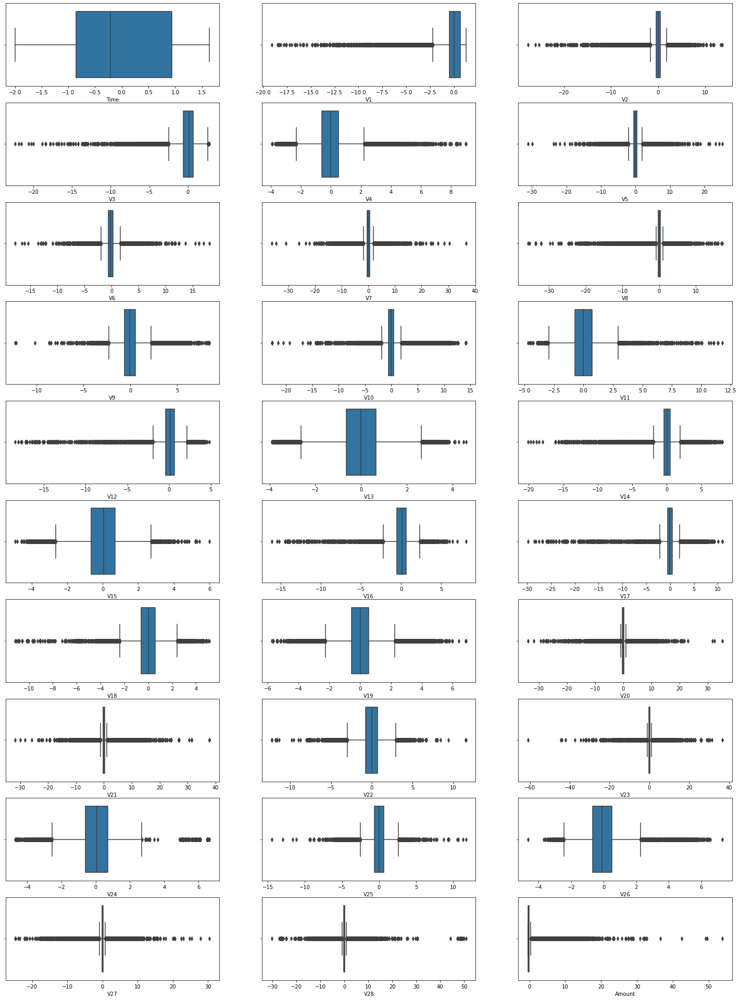

In [ ]:
num_cols = X_train._get_numeric_data().columns 

plt.figure(figsize = (25,45))
for i in enumerate(num_cols):
  plt.subplot(13,3,i[0]+1)
  sns.boxplot(x=X_train[i[1]])
  plt.xlabel(i[1])

## Feature Selection & Engineering

In [8]:
y = pd.DataFrame(df['Class'])
df = df.drop(['Class'], axis=1)

X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.25, random_state=1, stratify=y)

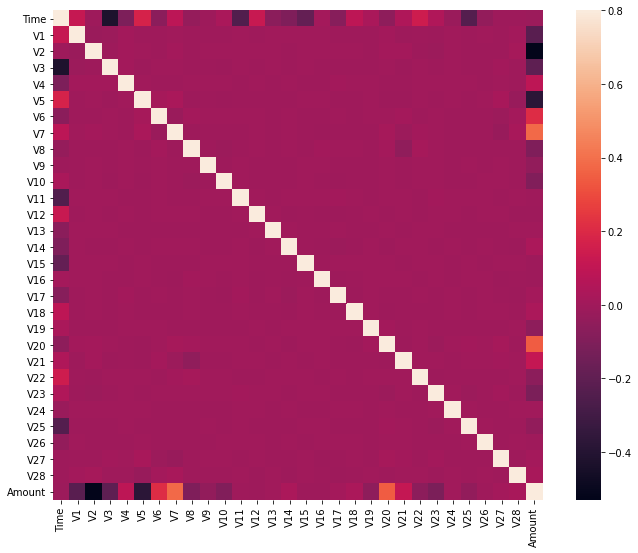

In [ ]:
correlation_matrix = X_train.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(correlation_matrix, vmax=.8, square=True);

In [ ]:
upper = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(np.bool))
upper.head(30)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
Time,NaN,0.119228,-0.010036,-0.422118,-0.106372,0.175315,-0.063710,0.087268,-0.035381,-0.009014,0.029716,-0.246872,0.124607,-0.065359,-0.099472,-0.184872,0.012084,-0.075303,0.089947,0.028728,-0.052388,0.043865,0.142767,0.050731,-0.017020,-0.234239,-0.040969,-0.007691,-0.008855,-0.011201
V1,NaN,NaN,-0.018243,-0.011258,0.007573,-0.001952,-0.000684,0.000791,-0.002452,-0.001270,-0.001385,0.000687,-0.000569,0.001889,0.001177,0.000399,0.001268,-0.002622,-0.001989,-0.000498,0.008898,-0.005542,-0.001250,-0.007201,0.001326,-0.001501,0.000270,0.000074,0.007547,-0.220586
V2,NaN,NaN,NaN,-0.007932,0.010068,0.001827,-0.003387,0.010812,-0.000862,0.001312,0.000353,0.003083,0.002332,0.004215,-0.001021,0.003602,0.002282,0.000469,0.001035,-0.000823,0.010740,0.011884,-0.010189,-0.011050,0.002618,-0.002139,-0.000802,-0.003564,0.017266,-0.529729
V3,NaN,NaN,NaN,NaN,0.006077,-0.009542,0.004214,0.003748,-0.002333,-0.003366,-0.005529,0.002375,-0.001906,0.002585,-0.000308,0.000861,-0.000231,-0.004895,-0.001699,-0.000109,0.000968,-0.006371,0.000659,-0.005018,0.001303,-0.001795,-0.000433,0.009266,-0.003689,-0.203432
V4,NaN,NaN,NaN,NaN,NaN,0.003415,-0.001473,-0.002790,0.000850,0.001130,0.004524,-0.002614,0.002303,-0.002784,0.002837,-0.000707,-0.000012,0.005799,0.002196,0.000418,-0.001712,-0.000022,0.001221,0.000844,0.000694,0.002299,-0.000431,0.000969,-0.001004,0.090177
V5,NaN,NaN,NaN,NaN,NaN,NaN,0.015692,0.026875,-0.006429,-0.004190,-0.007243,-0.000025,-0.004600,-0.000027,-0.001272,0.000845,0.004430,-0.004159,-0.001756,0.000951,-0.009976,-0.009223,0.001012,-0.004539,0.000095,-0.000271,0.001672,0.023643,-0.022045,-0.376124
V6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.017352,0.011011,0.001120,0.003274,0.001093,0.001239,-0.001080,0.000360,-0.000500,-0.003477,0.000112,-0.002070,0.002350,0.004974,0.014185,-0.002472,0.000115,-0.000870,-0.000723,-0.000966,-0.011221,0.015166,0.208591
V7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.005762,-0.001299,-0.003794,-0.001434,0.001785,-0.004212,0.000996,-0.002373,-0.006565,-0.000804,-0.000507,-0.001031,0.019717,-0.012363,0.006555,0.003331,-0.003533,-0.001436,-0.001196,-0.023109,0.022191,0.381342
V8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.004880,-0.011445,-0.003459,0.004315,-0.003055,0.004361,-0.001784,0.006076,0.003631,0.003055,-0.004647,0.013620,-0.047605,0.016447,0.000358,-0.000307,-0.002877,-0.001684,-0.001162,-0.002775,-0.100705
V9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.005131,0.000970,-0.001071,-0.001515,-0.002327,0.000230,0.000566,-0.004866,-0.000807,-0.001118,0.002118,-0.000913,0.000237,0.003872,-0.000554,0.000171,-0.000562,0.001202,-0.002067,-0.041794


We can see that there are no non-trivial correlations between features. 

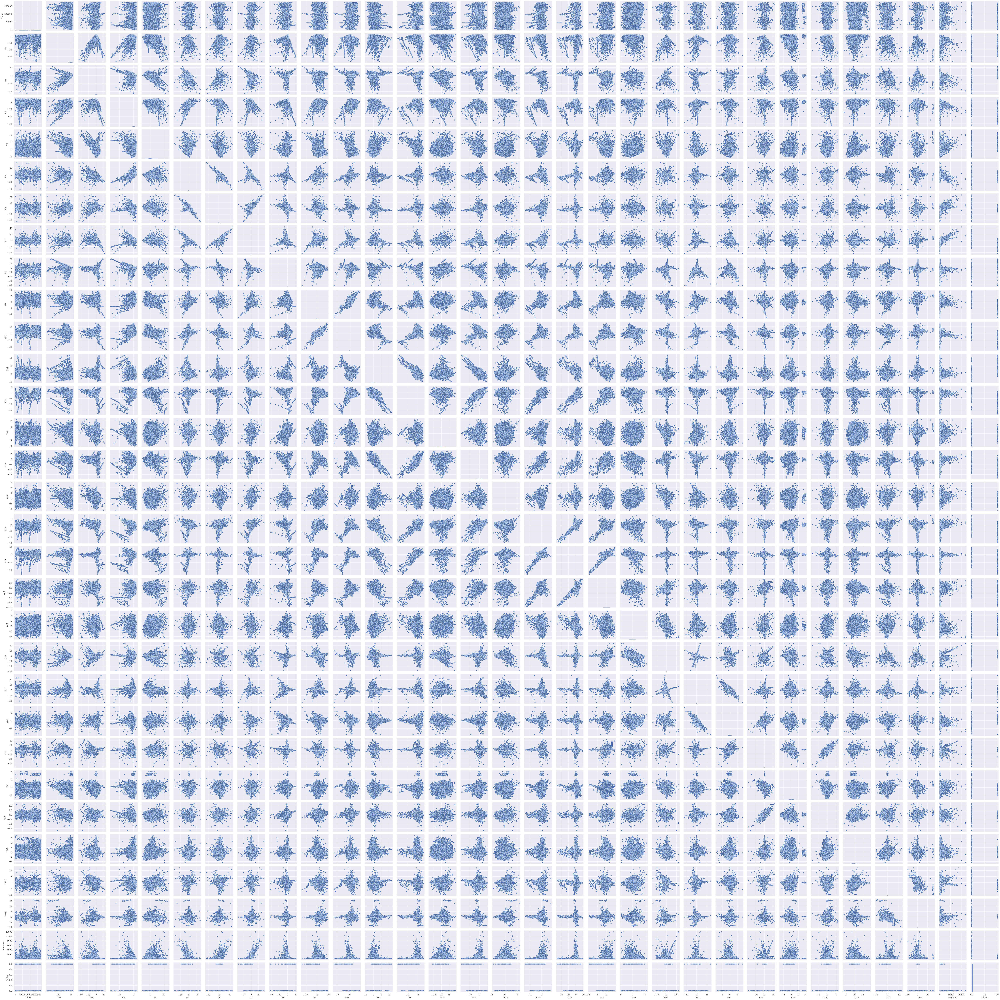

In [ ]:
sns.set()
sns.pairplot(X_train_copy_for_plot[X_train_copy_for_plot.columns], height = 2.5)
plt.show()

Following pairs 'appear' to be related.

1.   V5-6
2.   V9-V10
3.   V9-V10
4.   V11-V12
5.   V11-V14
6.   V12-V14
7.   V17-V16
8.   V17-V18
9.   V21-V22
10.  V23-V25

It seems like there is no relationship between "Time" and labels. There are relationships between labels and V2, V7, V9, V10, V16 that can we further exploit.

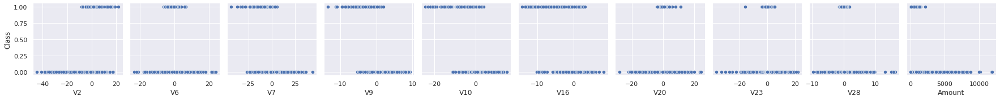

In [ ]:
sns.pairplot(data=X_train_copy_for_plot,
                  y_vars=['Class'],
                  x_vars=['V2', 'V6', 'V7', 'V9', 'V10', 'V16', 'V20', 'V23', 'V28', 'Amount'])

Although the relationships are not as clear-cut as we'd like, there are a few things we can deduce from the graphs. We see that all transactions with V2 < -12 are classifed as fraudulent, V7 > 5 are classified as non-fraudulent and V7 < -27 as fraudulent, V10 < -14 are fraudulent and V10 > 7 non-fraudulent, and V16 > 8 non-fraudulent and V16 < -11 as fraudulent. Furthermore,notice that all transactions valued over approx. 4000 are non-fraudulent. This may be due to the fact that most fraudulent transactions occur online which comes with limits (max. you can spend in a single transaction). Based on this, it is probable to assume that a decision tree could be a good fit for this task.

### Scaling Data

Before we do anything else, we need to scale our data.

In [9]:
s_scaler = StandardScaler()
temp = s_scaler.fit_transform(X_train)
X_train = pd.DataFrame(temp, columns = X_train.columns)
X_train.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
count,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05,2.135880e+05
mean,-1.106506e-16,2.861220e-17,4.398258e-18,-2.828161e-17,-1.986870e-17,-1.529930e-17,-1.232334e-17,3.895875e-18,-8.358458e-18,3.767173e-17,-1.083256e-18,-8.396273e-18,1.169854e-17,1.393003e-17,4.872898e-17,-1.754755e-17,-2.256645e-17,4.753539e-18,-1.559598e-17,1.805877e-17,-1.140015e-17,5.331774e-17,-2.427528e-17,5.946277e-17,-9.097999e-18,-9.511497e-18,1.853698e-17,8.740899e-18,1.166423e-18,-4.508663e-17
std,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00,1.000002e+00
min,-1.992106e+00,-1.909594e+01,-2.758883e+01,-2.234115e+01,-3.936485e+00,-3.108809e+01,-1.778260e+01,-3.624389e+01,-3.565471e+01,-1.227373e+01,-2.269583e+01,-4.703734e+00,-1.842724e+01,-3.907859e+00,-2.009414e+01,-4.917186e+00,-1.615170e+01,-2.977266e+01,-1.114735e+01,-5.749761e+00,-3.383238e+01,-3.175100e+01,-1.228733e+01,-6.090644e+01,-4.688126e+00,-1.445687e+01,-4.650648e+00,-2.477177e+01,-3.025012e+01,-3.681598e-01
25%,-8.543590e-01,-4.755158e-01,-3.713767e-01,-5.908703e-01,-6.003036e-01,-5.098884e-01,-5.801506e-01,-4.602624e-01,-1.814515e-01,-5.883566e-01,-4.943206e-01,-7.478303e-01,-4.053766e-01,-6.521695e-01,-4.453320e-01,-6.370877e-01,-5.349006e-01,-5.723955e-01,-5.950278e-01,-5.610701e-01,-2.821349e-01,-3.184920e-01,-7.492215e-01,-2.687316e-01,-5.852867e-01,-6.119640e-01,-6.790974e-01,-1.758858e-01,-1.655540e-01,-3.447814e-01
50%,-2.124540e-01,7.547335e-03,3.887335e-02,1.185526e-01,-1.297258e-02,-3.937617e-02,-2.080066e-01,3.311131e-02,1.712606e-02,-4.775049e-02,-8.584120e-02,-3.189895e-02,1.399291e-01,-1.340586e-02,5.163127e-02,5.330604e-02,7.700096e-02,-7.816997e-02,-5.511351e-03,5.762880e-03,-8.237251e-02,-4.150962e-02,1.026745e-02,-1.878547e-02,6.700115e-02,3.113087e-02,-1.088814e-01,4.752072e-03,3.701220e-02,-2.758213e-01
75%,9.378590e-01,6.773429e-01,4.960815e-01,6.805547e-01,5.268425e-01,4.509909e-01,3.005400e-01,4.738891e-01,2.796493e-01,5.441932e-01,4.176263e-01,7.253667e-01,6.198986e-01,6.659324e-01,5.165874e-01,7.079773e-01,5.983515e-01,4.715763e-01,5.981874e-01,5.626580e-01,1.784912e-01,2.587889e-01,7.296627e-01,2.440408e-01,7.249791e-01,6.752761e-01,5.000461e-01,2.283143e-01,2.480026e-01,-4.707346e-02
max,1.643533e+00,1.265014e+00,1.362890e+01,2.800531e+00,8.996154e+00,2.515043e+01,1.810605e+01,3.665514e+01,1.719299e+01,8.469368e+00,1.415184e+01,1.177992e+01,4.846918e+00,4.590685e+00,8.042524e+00,6.011909e+00,8.067694e+00,1.094993e+01,5.130422e+00,6.880883e+00,3.519760e+01,3.788532e+01,1.156210e+01,3.668337e+01,6.647014e+00,1.170726e+01,7.295823e+00,3.042530e+01,5.073422e+01,5.382169e+01


In [10]:
temp = s_scaler.transform(X_test)
X_test = pd.DataFrame(temp, columns = X_test.columns)
X_test.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
count,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000,71196.000000
mean,0.011393,0.003661,-0.005113,-0.007576,0.004665,-0.001490,0.008740,-0.005909,-0.002790,-0.006013,-0.000215,-0.005124,0.004608,-0.002152,-0.005369,-0.001760,-0.004918,0.003530,0.002535,0.009442,0.006641,0.000916,0.001510,0.002807,-0.003002,-0.002618,-0.002154,0.005665,0.003667,0.005798
std,0.996604,1.000854,1.002165,1.006161,1.004011,1.006981,1.002208,1.020932,1.031942,1.007674,1.007324,1.000747,0.993925,0.998850,1.002912,0.999079,1.000991,1.018165,1.002587,1.003015,1.019749,1.039425,1.005092,1.044170,1.002271,1.010242,1.000459,0.967523,0.996070,1.020286
min,-1.992106,-19.355555,-24.609561,-21.102608,-4.023639,-25.950262,-15.133133,-27.658665,-34.110968,-9.906269,-20.479451,-4.142380,-18.679789,-4.028474,-18.427587,-4.377963,-15.153821,-27.076302,-11.342664,-6.065453,-37.571350,-25.950782,-12.287329,-54.532729,-4.664590,-16.772866,-3.849375,-24.517216,-25.970285,-0.368160
25%,-0.844728,-0.470894,-0.374909,-0.597071,-0.596972,-0.512627,-0.576047,-0.467066,-0.179487,-0.589819,-0.493832,-0.750947,-0.401306,-0.651949,-0.449148,-0.637900,-0.539288,-0.568993,-0.595101,-0.553327,-0.282503,-0.318417,-0.750233,-0.269037,-0.590341,-0.613831,-0.678250,-0.176274,-0.164447,-0.344488
50%,-0.198220,0.014378,0.035960,0.111890,-0.011800,-0.044918,-0.197518,0.029340,0.018707,-0.049365,-0.085329,-0.036660,0.145536,-0.016003,0.051383,0.048189,0.067582,-0.072881,0.001720,0.010389,-0.081002,-0.041285,0.009076,-0.017629,0.067027,0.031263,-0.108308,0.004490,0.035852,-0.275569
75%,0.944282,0.679874,0.488623,0.674051,0.530612,0.449673,0.314305,0.471526,0.279825,0.544197,0.422096,0.719065,0.617815,0.663274,0.506627,0.710693,0.592908,0.480030,0.599728,0.575978,0.185858,0.259910,0.735600,0.248431,0.727164,0.676752,0.497485,0.231937,0.245619,-0.036580
max,1.643448,1.248306,10.762017,2.775130,9.310712,21.214227,16.314185,30.683300,16.472036,8.323367,12.748838,10.930640,4.293889,4.486588,7.256431,6.193932,9.474472,9.190588,5.068554,5.908067,26.490414,37.885320,11.438004,34.556810,6.575579,11.235357,7.183597,26.308195,50.144607,41.603915


### LightGBM Feature Importances

In [ ]:
lgbm_feature_selector = lgb.LGBMClassifier(objective='binary', boosting_type = 'goss', n_estimators = 50000, class_weight = 'balanced')
lgbm_feature_selector.fit(X_train, y_train, early_stopping_rounds=100, eval_set=[(X_test, y_test)], eval_metric='recall', verbose=200)
lgbm_feature_selector.feature_importances_

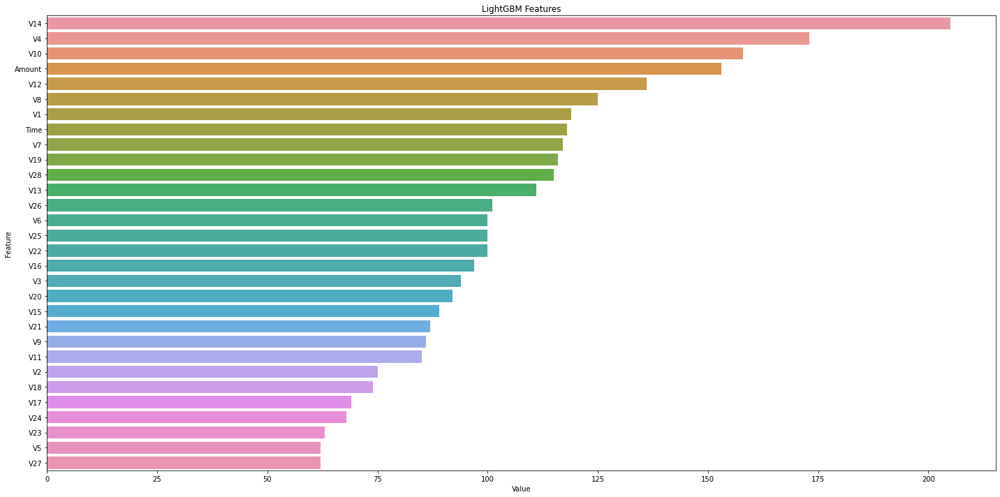

In [ ]:
warnings.simplefilter(action='ignore', category=FutureWarning)

feature_imp = pd.DataFrame(sorted(zip(lgbm_feature_selector.feature_importances_,X_train.columns)), columns=['Value','Feature'])

plt.figure(figsize=(20, 10))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title('LightGBM Features')
plt.tight_layout()
plt.show()

For some reason LGBM determined "Time" to be a relatively important feature, even though there didn't seem to be any relationship between label and itself. Interesting!

28 features required for 0.95 of cumulative importance


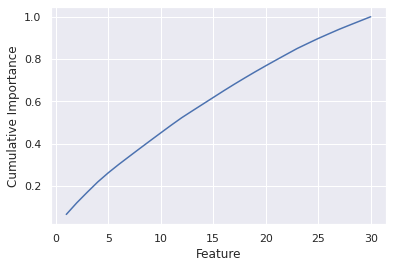

In [ ]:
def plot_feature_importances(df, threshold = 0.95):    
    df = df.sort_values('Value', ascending = False).reset_index()
    df['importance_normalized'] = df['Value'] / df['Value'].sum()
    df['cumulative_importance'] = np.cumsum(df['importance_normalized'])

    x_l = np.arange(1, len(df) + 1)
    y_l = df['cumulative_importance']
    dataf = {'Feature': x_l, 'Cumulative Importance': y_l}
    pdsnsci = pd.DataFrame(dataf)

    sns.set(style='darkgrid')
    sns.lineplot(x='Feature', y='Cumulative Importance', data = pdsnsci)

    importance_index = np.min(np.where(df['cumulative_importance'] > threshold))
    print('%d features required for %0.2f of cumulative importance' % (importance_index + 1, threshold))
    
    return df

norm_feature_importances = plot_feature_importances(feature_imp)

### Recursive Feature Elimination

In [ ]:
rfe = RFE(estimator=LogisticRegression(solver='liblinear'), n_features_to_select=15)
fts = rfe.fit(X_train, y_train)
fts.support_

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([ True, False, False, False,  True,  True, False, False,  True,
        True,  True, False, False,  True,  True, False,  True, False,
       False, False,  True,  True,  True, False, False,  True, False,
        True, False,  True])

In [ ]:
fts.ranking_

array([ 1,  3, 13, 16,  1,  1,  5,  2,  1,  1,  1,  7,  4,  1,  1, 12,  1,
        9, 14,  8,  1,  1,  1, 11, 15,  1, 10,  1,  6,  1])

### Feature Engineering

In [ ]:
X_train['Amount Bin'] = 0
X_train.loc[X_train['Amount'] >= 5000, 'Amount Bin'] = 1

X_train['V2 < -15'] = 0
X_train.loc[X_train['V2'] < -15, 'V2 < -15'] = 1

X_train = X_train.drop(['Amount', 'V2'], axis=1)

In [ ]:
X_test['Amount Bin'] = 0
X_test.loc[X_test['Amount'] >= 5000, 'Amount Bin'] = 1

X_test['V2 < -15'] = 0
X_test.loc[X_test['V2'] < -15, 'V2 < -15'] = 1

X_test = X_test.drop(['Amount', 'V2'], axis=1)

Ran the models using the engineered features above but they didn't improve the performance.

### PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=15)
X_pca = pca.fit_transform(X_train)
PCA_df = pd.DataFrame(data = X_pca, columns = ['PC1', 'PC2','PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10', 'PC11', 'PC12', 'PC13', 'PC14', 'PC15'])

PCA_df.head(10)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15
0,-0.354700,1.871590,-0.841195,-1.304193,-0.377083,-0.132497,-0.406489,0.662035,-0.247624,1.410238,-0.822374,-0.224483,-0.108590,0.471524,-0.740856
1,-0.572300,1.665711,0.862411,0.505970,0.118470,-1.182744,-0.583617,-1.052102,0.560165,-0.788615,0.541849,-0.092718,0.522563,-1.082386,-0.898740
2,-0.441228,1.044695,-1.017517,-0.247447,0.487928,1.325335,1.311343,0.541965,0.393675,1.053350,-0.425648,-0.097852,-0.686064,0.227101,-1.000969
3,-0.046575,-1.201918,-0.365607,-0.486660,-0.894081,1.310000,-0.821552,-0.517706,-1.713691,0.635882,0.169957,1.015927,-0.889422,0.775962,0.089966
4,-0.428844,-1.132849,-0.713941,-0.639152,-0.164394,-0.385180,0.662498,0.201810,-0.194309,0.330043,0.519597,-1.031080,0.410425,-0.515982,0.359196
5,-0.522892,1.168738,0.355478,0.831098,0.012299,-0.614668,0.246125,-0.838063,0.025154,-0.277935,-0.773115,0.046444,0.526547,0.031797,0.469705
6,-0.108653,-1.619187,-0.044740,0.484609,0.426660,-0.901730,0.675786,0.912924,-1.603542,-0.116461,-0.074937,0.900233,-0.315739,0.682626,-3.591638
7,-0.631947,1.513107,0.325429,-0.752754,-0.348187,0.692446,0.057879,0.238185,0.126255,0.730540,-0.486789,0.794442,-0.606663,-0.100062,1.538966
8,-0.115299,-0.398106,0.329825,-0.129142,-0.661509,-0.358023,-0.526262,0.462194,-0.751026,0.723637,1.806321,-2.083573,0.138645,-0.586477,-0.097731
9,-0.635128,1.400365,0.371583,1.288092,0.057348,1.773804,-1.486225,1.537455,1.446692,-0.624281,1.564415,-1.125117,-1.661361,-0.417351,0.875053


I have tested the PCA with 10 components which made the prediction results worse. PCA with 15 components returned the best results with Decision Tree classifier.

In [ ]:
PCA_test = pca.transform(X_test)
PCA_test_df = pd.DataFrame(data=PCA_test, columns=['PC1', 'PC2','PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10', 'PC11', 'PC12', 'PC13', 'PC14', 'PC15'])
PCA_test_df.head(10)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15
0,-0.132668,-1.349995,-0.849470,-1.016255,-0.186182,0.114564,0.918500,-0.698673,-0.616134,0.456606,0.428087,-0.960710,-0.052124,-0.679774,-0.365433
1,0.023119,-1.926293,-1.370463,-0.439379,-0.493076,-0.219451,0.885502,1.454092,0.519841,0.253566,-2.538097,0.154523,-0.450016,-1.752784,-1.279492
2,-0.253791,-3.022462,-1.034053,-0.636124,-0.760620,-0.647197,0.420053,1.568004,0.893927,-0.493099,-1.589324,-0.362030,0.699523,-1.039068,-0.531380
3,-0.440972,-1.840474,-0.441652,0.211038,-0.959472,0.709130,0.018130,-0.002056,-0.011759,-0.314352,0.692583,0.383084,-1.347429,-0.904028,-0.042103
4,0.153250,-1.561954,0.147329,0.169218,1.332268,-0.002251,0.073274,-1.463060,-0.269089,-0.132229,-1.101440,0.815616,-0.037693,-0.727416,-0.747553
5,-0.273474,-2.057840,-0.039546,-0.050715,0.409394,-0.572535,1.134897,-0.287379,-0.541163,-0.639846,0.049128,-1.219031,-2.383724,1.483838,-2.658969
6,-0.345909,-0.493058,-1.123488,0.442902,0.247609,-0.370198,0.077482,0.706771,0.279490,0.607679,0.672177,0.646508,0.022159,-0.850604,0.051050
7,2.487194,1.981740,-0.180348,-0.777420,0.884923,0.098507,-1.113558,0.706130,-0.522401,-1.100924,-1.356882,0.188708,-1.698133,0.964908,-2.033658
8,-0.314740,-1.707736,-0.805963,-0.484707,-0.082549,0.036148,0.721091,0.285628,0.311482,1.011603,-0.397540,0.257395,-1.205189,0.846100,-0.773901
9,6.478181,-1.304787,0.884724,0.774536,-0.976180,-0.128974,3.849374,0.701460,0.765690,-0.001735,-1.343525,2.116794,-1.221562,0.340250,1.909125


In [ ]:
pca_feature_importances = np.zeros(PCA_df.shape[1])

for i in range(3):
  X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(PCA_df, y_train, test_size=0.25, random_state=i)
  lgbm_feature_selector.fit(X_train_pca, y_train_pca, early_stopping_rounds=100, eval_set=[(X_test_pca, y_test_pca)], eval_metric='aucpr', verbose=200)
  pca_feature_importances += lgbm_feature_selector.feature_importances_

In [ ]:
pca_feature_importances = pca_feature_importances / 2
pca_feature_importances_df = pd.DataFrame({'feature': PCA_df.columns.values, 'importance': pca_feature_importances}).sort_values('importance', ascending = False)
pca_feature_importances = plot_feature_importances(pca_feature_importances_df)

In [ ]:
# Checking skewness 
skewed_feats = X_train[X_train.columns].apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
skewness = pd.DataFrame()
skewness['Skew_value'] = skewed_feats
skewness.head(20)

# ML Models

### **Logistic Regression**

In [ ]:
Logistic_Model_pca = LogisticRegression(class_weight='balanced')

Logistic_Model_pca.fit(PCA_df, y_train)
Y_pred_pca = Logistic_Model_pca.predict(PCA_test_df)

,Metric,Value
0,Average Precision,0.020345
1,Precision,0.022546
2,Recall,0.894309
3,Balanced Accuracy,0.913604


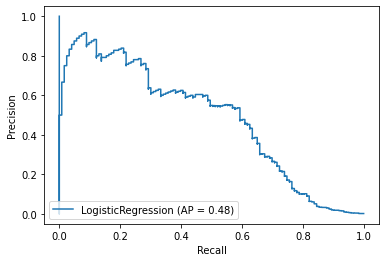

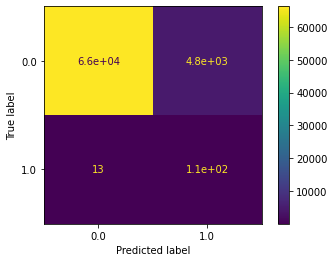

In [ ]:
average_precision_lc_pca = average_precision_score(y_test, Y_pred_pca)
balanced_accuracy_lc_pca = balanced_accuracy_score(y_test, Y_pred_pca)
precision_lc_pca = precision_score(y_test, Y_pred_pca)
recall_lc_pca = recall_score(y_test, Y_pred_pca)
plot_precision_recall_curve(Logistic_Model_pca, PCA_test_df, y_test)
plot_confusion_matrix(Logistic_Model_pca, PCA_test_df, y_test)  

lc_metrics_list = [['Average Precision', average_precision_lc_pca], ['Precision', precision_lc_pca], ['Recall', recall_lc_pca], ['Balanced Accuracy', balanced_accuracy_lc_pca]]
 
lc_metrics_df_pca = pd.DataFrame(lc_metrics_list, columns = ['Metric', 'Value'])
lc_metrics_df_pca

In [ ]:
Logistic_Model_normal = LogisticRegression(class_weight='balanced')

Logistic_Model_normal.fit(X_train, y_train)
Y_pred_normal = Logistic_Model_normal.predict(y_test)

,Metric,Value
0,Average Precision,0.056718
1,Precision,0.062119
2,Recall,0.910569
3,Balanced Accuracy,0.943388


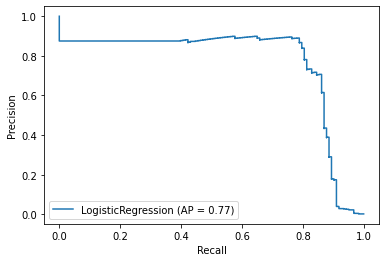

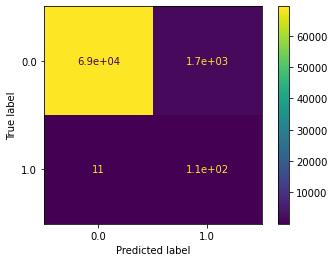

In [ ]:
average_precision_lc_normal = average_precision_score(y_test, y_pred_normal)
balanced_accuracy_lc_normal = balanced_accuracy_score(y_test, y_pred_normal)
precision_lc_normal = precision_score(y_test, y_pred_normal)
recall_lc_normal = recall_score(y_test, y_pred_normal)
plot_precision_recall_curve(Logistic_Model_normal, X_test, y_test)
plot_confusion_matrix(Logistic_Model_normal, X_test, y_test)  

lc_metrics_list_normal = [['Average Precision', average_precision_lc_normal], ['Precision', precision_lc_normal], ['Recall', recall_lc_normal], ['Balanced Accuracy', balanced_accuracy_lc_normal]]
 
lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
lc_metrics_df_normal

For Logistic Regression PCA results in worse precision but similar recall scores. 

### **SVC**

In [ ]:
class SVC_Model():
  def __init__(self, x_train, y_train, x_test, y_test):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.predictions = None
    self.model = None

  def get_preds(self):
    if self.predictions != None:
      return self.predictions
    else:
      return 'Run the model for SVC first.'

  def run_model(self):
    self.model = SVC()
    self.model.fit(self.x_train, self.y_train)
    self.predictions = self.model.predict(self.x_test)

    average_precision = average_precision_score(self.y_test, self.predictions)
    balanced_accuracy = balanced_accuracy_score(self.y_test, self.predictions)
    precision = precision_score(self.y_test, self.predictions)
    recall = recall_score(self.y_test, self.predictions)
    plot_precision_recall_curve(self.model, self.x_test, self.y_test)
    plot_confusion_matrix(self.model, self.x_test, self.y_test)  

    lc_metrics_list_normal = [['Average Precision', average_precision], ['Precision', precision], ['Recall', recall], ['Balanced Accuracy', balanced_accuracy]]
    
    lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
    return lc_metrics_df_normal

,Metric,Value
0,Average Precision,0.205387
1,Precision,0.250000
2,Recall,0.820144
3,Balanced Accuracy,0.907665


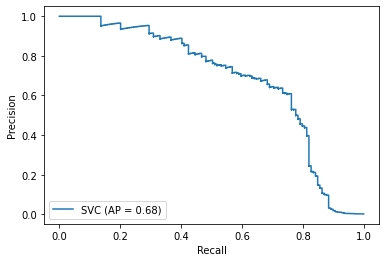

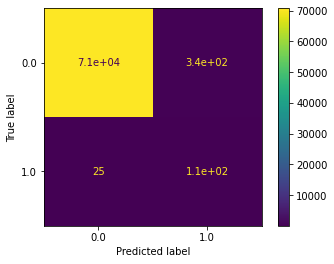

In [ ]:
# SVC with SMOTE oversampled training data 
svc_model = SVC_Model(sampled_x_train, sampled_y_train, X_test, y_test)
svc_model.run_model()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,Metric,Value
0,Average Precision,0.684832
1,Precision,0.956522
2,Recall,0.715447
3,Balanced Accuracy,0.857695


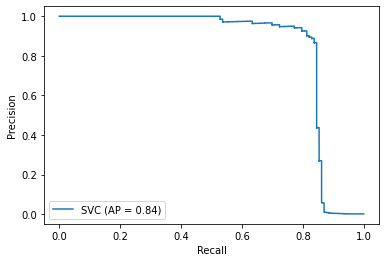

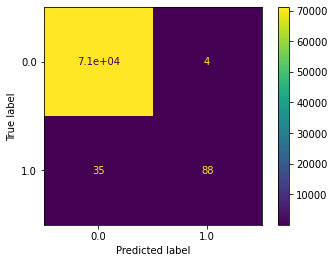

In [ ]:
# SVC Model with unmodified training data
svc_model = SVC_Model(X_train, y_train, X_test, y_test)
svc_model.run_model()

### **Decision Tree**

In [ ]:
class DecisionTree_Model():
  def __init__(self, x_train, y_train, x_test, y_test):
    self.x_train = x_train
    self.y_train = y_train
    self.x_train_resampled = None
    self.y_train_resampled = None
    self.x_test = x_test
    self.y_test = y_test
    self.predictions = [None]
    self.model = None
    self.best_hyperparams = {}

  def get_preds(self):
    if self.predictions != None:
      return self.predictions
    else:
      return 'Run the model for Decision Tree first.'

  def get_bestparams(self):
    return self.best_hyperparams

  def objective(self, space):
    model = DecisionTreeClassifier(class_weight='balanced')
    oversample = SMOTE(sampling_strategy = space['smote_sampling'], k_neighbors = 4)
    undersample = RandomUnderSampler(sampling_strategy = space['random_under_sampling'])
    steps = [('over', oversample), ('under', undersample)]
    pipeline = Pipeline(steps = steps)
    (x, y) = pipeline.fit_resample(self.x_train, self.y_train)
    model.fit(x, y)
    pred = model.predict(self.x_test)
    precision, recall, _ = precision_recall_curve(self.y_test, pred)
    area = auc(recall, precision)
    accuracy = area 
    return {'loss': -accuracy, 'status': STATUS_OK }

  def hyperparam_search(self, smote_sampling = hp.uniform('smote_sampling', 0.11, 0.125),
                        random_under_sampling = hp.uniform('random_under_sampling', 0.88, 0.92),
                        k = hp.uniform('k', 3, 5)):
    
    space = {'smote_sampling': smote_sampling,
             'random_under_sampling': random_under_sampling, 'k': k }

    trials = Trials()
    self.best_hyperparams = fmin(fn = self.objective, space = space, algo = tpe.suggest, max_evals = 100, trials = trials)

  def run_model(self, k_, sampling = True, kn=6, smote_sampling = 0.15, random_under_sampling = 0.5, n_splits = 10, n_repeats = 3, is_k_given = False):
    if sampling:
      if not is_k_given:
        best_k = 0
        for k in range(1, kn + 1):
          self.model = DecisionTreeClassifier()
          oversample = SMOTE(sampling_strategy = smote_sampling, k_neighbors = k)
          undersample = RandomUnderSampler(sampling_strategy = random_under_sampling)
          steps = [('over', oversample), ('under', undersample), ('model', self.model)]
          pipeline = Pipeline(steps = steps)
          cross_val = RepeatedStratifiedKFold(n_splits = n_splits, n_repeats = n_repeats, random_state=1)
          scores = cross_val_score(pipeline, X_train, y_train, scoring='roc_auc', cv = cross_val, n_jobs=-1)
          best_k = math.max(np.mean(scores), best_k)
        k_ = best_k

      self.model = DecisionTreeClassifier(class_weight='balanced')
      oversample = SMOTE(sampling_strategy = smote_sampling, k_neighbors = k_)
      undersample = RandomUnderSampler(sampling_strategy = random_under_sampling)
      steps = [('over', oversample), ('under', undersample)]
      pipeline = Pipeline(steps = steps)
      (self.x_train_resampled, self.y_train_resampled) = pipeline.fit_resample(self.x_train, self.y_train)
      self.model.fit(self.x_train_resampled, self.y_train_resampled)
      self.predictions = self.model.predict(self.x_test)
    else:
      self.model = DecisionTreeClassifier(class_weight='balanced')
      self.model.fit(self.x_train, self.y_train)
      self.predictions = self.model.predict(self.x_test)

  def metrics(self):
    average_precision = average_precision_score(self.y_test, self.predictions)
    balanced_accuracy = balanced_accuracy_score(self.y_test, self.predictions)
    precision = precision_score(self.y_test, self.predictions)
    recall = recall_score(self.y_test, self.predictions)
    plot_precision_recall_curve(self.model, self.x_test, self.y_test)
    plot_confusion_matrix(self.model, self.x_test, self.y_test)  
    lc_metrics_list_normal = [['Average Precision', average_precision], ['Precision', precision], ['Recall', recall], ['Balanced Accuracy', balanced_accuracy]]
    
    lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
    return lc_metrics_df_normal

In [ ]:
dt_c = DecisionTree_Model(X_train, y_train, X_test, y_test)
dt_c.hyperparam_search()
best_p = dt_c.get_bestparams()
print(best_p)

#### Decision Tree with SMOLE Oversampling

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,Metric,Value
0,Average Precision,0.188564
1,Precision,0.222698
2,Recall,0.845528
3,Balanced Accuracy,0.920211


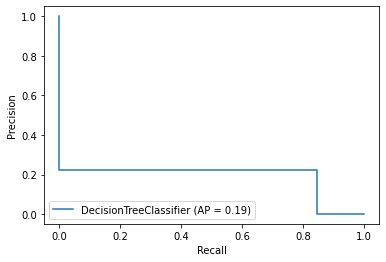

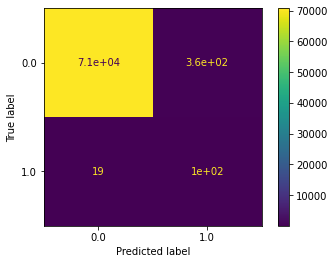

In [ ]:
# Decision Tree without SMOLE Oversampling
warnings.simplefilter(action='ignore', category=FutureWarning)

d_tree = DecisionTree_Model(X_train, y_train, X_test, y_test)
d_tree.run_model(k_ = 4, is_k_given=True)
d_tree.metrics()

#### Decision Tree without SMOLE Oversampling

,Metric,Value
0,Average Precision,0.613283
1,Precision,0.761538
2,Recall,0.804878
3,Balanced Accuracy,0.902221


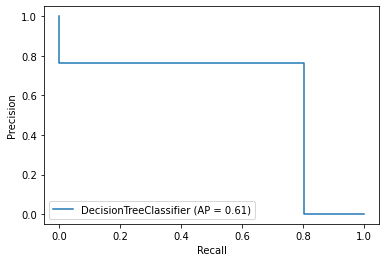

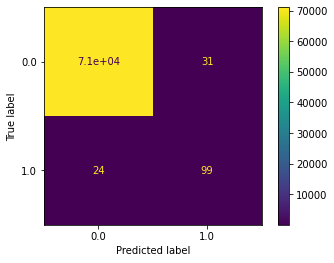

In [ ]:
d_tree_nosampling = DecisionTree_Model(X_train, y_train, X_test, y_test)
d_tree_nosampling.run_model(k_ = 4, sampling=False)
d_tree_nosampling.metrics()

Decision Tree has better balanced accuracy (therefore better recall) with Random Undersampling and SMOTE Oversampling.

### **XGBoost and LightGBM (with Hyperparameter Tuning)**

In [ ]:
class XGBoost():
  def __init__(self, x_train, y_train, x_test, y_test, df = None):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.df = df
    self.best_params = {}
    self.predictions = None
    self.model = None

  def get_bestparams(self):
    return self.best_hyperparams

  def objective(self, space):
    clf = xgb.XGBClassifier(
        n_estimators = int(space['n_estimators']), max_depth = int(space['max_depth']), gamma = space['gamma'],
        reg_alpha = int(space['reg_alpha']), min_child_weight = int(space['min_child_weight']),
        colsample_bytree = int(space['colsample_bytree'])
    )

    oversample = SMOTE(sampling_strategy = 0.12, k_neighbors = 4)
    undersample = RandomUnderSampler(sampling_strategy = 0.9)
    steps = [('over', oversample), ('under', undersample)]
    pipeline = Pipeline(steps = steps)
    (x, y) = pipeline.fit_resample(self.x_train, self.y_train)
    evaluation = [( x, y), ( self.x_test.to_numpy(), self.y_test.to_numpy())]

    clf.fit(x, y, eval_set=evaluation, eval_metric="aucpr", verbose=False)
    
    pred = clf.predict(self.x_test.to_numpy())
    accuracy = balanced_accuracy_score(self.y_test.to_numpy(), pred)
    return {'loss': -accuracy, 'status': STATUS_OK }

  def hyperparam_search(self, max_depth = hp.quniform("max_depth", 3, 32, 1), 
                        gamma = hp.uniform ('gamma', 1, 18), reg_alpha = hp.quniform('reg_alpha', 40, 280, 1), 
                        reg_lambda = hp.uniform('reg_lambda', 0, 1), colsample_bytree = hp.uniform('colsample_bytree', 0.5,1),
                        min_child_weight = hp.quniform('min_child_weight', 0, 10, 1), n_estimators = hp.uniform('n_estimators', 300, 700), seed = 0):
    
    space = {'max_depth': max_depth, 'gamma': gamma, 'reg_alpha': reg_alpha,
             'reg_lambda': reg_lambda, 'colsample_bytree': colsample_bytree,
             'min_child_weight': min_child_weight, 'n_estimators': n_estimators,
             'seed': seed }

    trials = Trials()
    self.best_hyperparams = fmin(fn = self.objective, space = space, algo = tpe.suggest, max_evals = 100, trials = trials)

  def run_with_hyperparams(self, best_hyperparams):
    self.model = xgb.XGBClassifier(n_estimators = int(best_hyperparams['n_estimators']), max_depth = int(best_hyperparams['max_depth']),
                              gamma = best_hyperparams['gamma'], reg_alpha = int(best_hyperparams['reg_alpha']), 
                              min_child_weight = int(best_hyperparams['min_child_weight']), colsample_bytree = int(best_hyperparams['colsample_bytree'])
                              )
    
    self.model.fit(self.x_train, self.y_train)
    self.predictions = self.model.predict(self.x_test)
    return self.metrics()

  def metrics(self):
    average_precision = average_precision_score(self.y_test, self.predictions)
    balanced_accuracy = balanced_accuracy_score(self.y_test, self.predictions)
    precision = precision_score(self.y_test, self.predictions)
    recall = recall_score(self.y_test, self.predictions)
    plot_precision_recall_curve(self.model, self.x_test, self.y_test)
    plot_confusion_matrix(self.model, self.x_test, self.y_test)  
    lc_metrics_list_normal = [['Average Precision', average_precision], ['Precision', precision], ['Recall', recall], ['Balanced Accuracy', balanced_accuracy]]
        
    lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
    return lc_metrics_df_normal

#### XGBoost without SMOLE Oversampling

In [ ]:
#xgboost = XGBoost(X_train, y_train, X_test, y_test)
#xgboost.hyperparam_search()
xgboost.run_with_hyperparams()

In [ ]:
xgboost.get_bestparams()

,Metric,Value
0,Average Precision,0.329680
1,Precision,0.842105
2,Recall,0.390244
3,Balanced Accuracy,0.695059


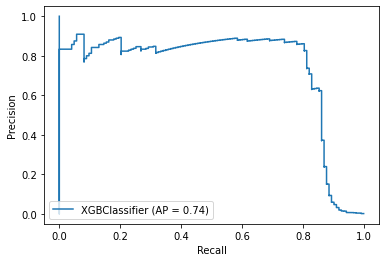

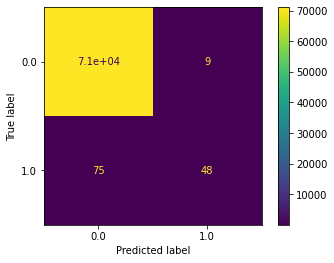

In [ ]:
best_hyps = {'colsample_bytree': 0.6987221432099037,
            'gamma': 17.931057490927834,
            'max_depth': 21.0,
            'min_child_weight': 6.0,
            'n_estimators': 984.2349382,
            'reg_alpha': 131.0,
            'reg_lambda': 0.9985811430279605 
             }

xgboost = XGBoost(X_train, y_train, X_test, y_test)
xgboost.run_with_hyperparams(best_hyps)

#### XGBoost with SMOLE Oversampling

I did not do another hyperparameter tuning for oversampled data because it takes more than an hour, even though it's probably a good idea to do so. 

,Metric,Value
0,Average Precision,0.324336
1,Precision,0.365772
2,Recall,0.886179
3,Balanced Accuracy,0.941760


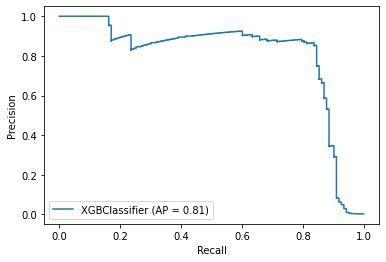

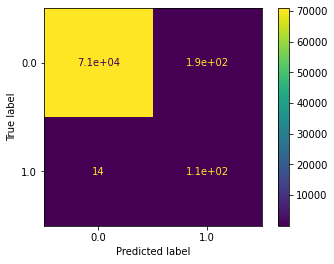

In [ ]:
best_hyps = {'colsample_bytree': 0.6987221432099037,
            'gamma': 17.931057490927834,
            'max_depth': 21.0,
            'min_child_weight': 6.0,
            'n_estimators': 984.2349382,
            'reg_alpha': 131.0,
            'reg_lambda': 0.9985811430279605 
             }

# Since SMOLE returns numpy array, we have to convert X_test
# and y_test to numpy as well.
xgboost = XGBoost(sampled_x_train, sampled_y_train, X_test.to_numpy(), y_test.to_numpy())
xgboost.run_with_hyperparams(best_hyps)

In [12]:
class LGBMBoost_Model():
  def __init__(self, x_train, y_train, x_test, y_test, df = None):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.df = df
    self.best_params = {}
    self.predictions = None
    self.model = None
  
  def get_bestparams(self):
    return self.best_hyperparams

  def objective(self, space):
    clf = lgb.LGBMClassifier(objective='binary', boosting_type='dart', n_estimators = 400,
                             max_depth = int(space['max_depth']), reg_alpha = float(space['reg_alpha']), reg_lambda = float(space['reg_lambda']),
                             min_child_weight = float(space['min_child_weight']), colsample_bytree = (space['colsample_bytree']),
                             is_unbalance = True, learning_rate=0.01, seed = 0
    )
    
    evaluation = [( self.x_train, self.y_train), ( self.x_test, self.y_test)]
    
    clf.fit(self.x_train, self.y_train,
        eval_set=evaluation, eval_metric="aucpr",verbose=False
    )
    
    pred = clf.predict(self.x_test)
    accuracy = balanced_accuracy_score(self.y_test.to_numpy(), pred)
    print("SCORE:", accuracy)
    return {'loss': -accuracy, 'status': STATUS_OK }

  def hyperparam_search(self, max_depth = hp.quniform("max_depth", 3, 56, 1), reg_alpha = hp.quniform('reg_alpha', 40,180,1), 
                      reg_lambda = hp.uniform('reg_lambda', 0,1), colsample_bytree = hp.uniform('colsample_bytree', 0.5,1),
                      min_child_weight = hp.quniform('min_child_weight', 0, 10, 1), n_estimators = hp.uniform('n_estimators', 300,2000),
                      seed = 0):
  
    space = {'max_depth': max_depth, 'reg_alpha': reg_alpha,
                  'reg_lambda': reg_lambda, 'colsample_bytree': colsample_bytree,
                  'min_child_weight': min_child_weight, 'n_estimators': n_estimators,
                  'seed': seed
              }

    trials = Trials()
    self.best_hyperparams = fmin(fn = self.objective, space = space, algo = tpe.suggest, max_evals = 70, trials = trials)

  def run_with_hyperparams(self, best_hyperparams, device = 'CPU'):
    self.model = lgb.LGBMClassifier(objective='binary', boosting_type='dart', n_estimators = int(best_hyperparams['n_estimators']), 
                               max_depth = int(best_hyperparams['max_depth']), reg_lambda = float(best_hyperparams['reg_lambda']),
                               reg_alpha = float(best_hyperparams['reg_alpha']), min_child_weight = float(best_hyperparams['min_child_weight']),
                               is_unbalance = True, colsample_bytree = (best_hyperparams['colsample_bytree']), learning_rate=0.01, device = device
                              )
    
    self.model.fit(self.x_train, self.y_train)
    self.predictions = self.model.predict(self.x_test)

  def metrics(self, preds=None):
    average_precision = average_precision_score(self.y_test, self.predictions)
    balanced_accuracy = balanced_accuracy_score(self.y_test, self.predictions)
    precision = precision_score(self.y_test, self.predictions)
    recall = recall_score(self.y_test, self.predictions)
    plot_precision_recall_curve(self.model, self.x_test, self.y_test)
    plot_confusion_matrix(self.model, self.x_test, self.y_test)  
    lc_metrics_list_normal = [['Average Precision', average_precision], ['Precision', precision], ['Recall', recall], ['Balanced Accuracy', balanced_accuracy]]
        
    lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
    return lc_metrics_df_normal

#### LGBoost without SMOLE Oversampling

In [ ]:
#lgbm_boost = LGBMBoost_Model(X_train, y_train, X_test, y_test)
#lgbm_boost.hyperparam_search()
lgbm_boost.get_bestparams()
#lgbm_boost.run_with_hyperparams()
#lgbm_boost.metrics()

{'colsample_bytree': 0.6379994297396409,
 'max_depth': 3.0,
 'min_child_weight': 3.0,
 'reg_alpha': 76.0,
 'reg_lambda': 0.6245822537306134}

,Metric,Value
0,Average Precision,0.081277
1,Precision,0.087558
2,Recall,0.926829
3,Balanced Accuracy,0.955057


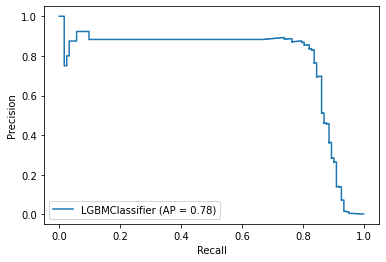

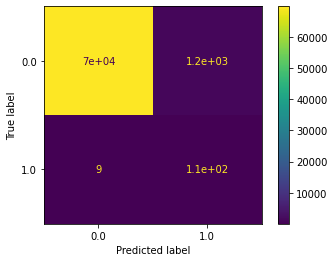

In [13]:
lgbmboost_best_hyperparams = {'colsample_bytree': 0.6379994297396409,
                            'max_depth': 3.0,
                            'min_child_weight': 3.0,
                            'reg_alpha': 76.0,
                            'reg_lambda': 0.6245822537306134,
                            'n_estimators': 400
                            }
lgbm_boost = LGBMBoost_Model(X_train, y_train, X_test, y_test)
lgbm_boost.run_with_hyperparams(lgbmboost_best_hyperparams, device = 'gpu')
lgbm_boost.metrics()

,Metric,Value
0,Average Precision,0.127954
1,Precision,0.140351
2,Recall,0.910569
3,Balanced Accuracy,0.950459


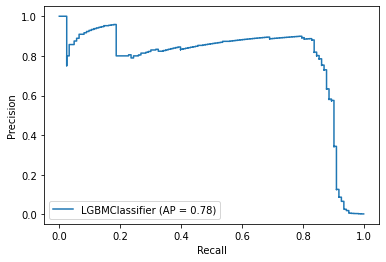

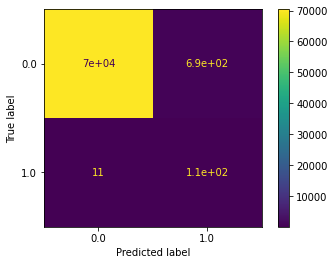

In [14]:
# Let's gradually increase number of n_estimators of LGBoost model.
lgbmboost_best_hyperparams['n_estimators'] = 2000
lgbm_boost.run_with_hyperparams(lgbmboost_best_hyperparams, device = 'gpu')
lgbm_boost.metrics()

,Metric,Value
0,Average Precision,0.443309
1,Precision,0.495495
2,Recall,0.894309
3,Balanced Accuracy,0.946367


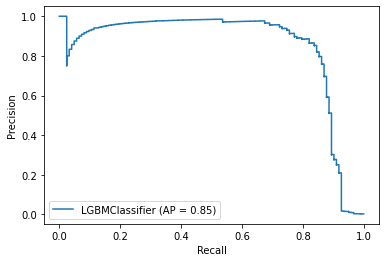

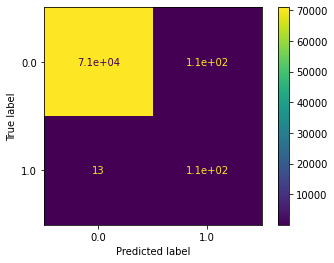

In [15]:
lgbmboost_best_hyperparams['n_estimators'] = 10000
lgbm_boost.run_with_hyperparams(lgbmboost_best_hyperparams, device = 'gpu')
lgbm_boost.metrics()

,Metric,Value
0,Average Precision,0.482408
1,Precision,0.539216
2,Recall,0.894309
3,Balanced Accuracy,0.946493


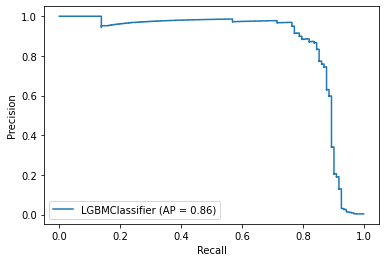

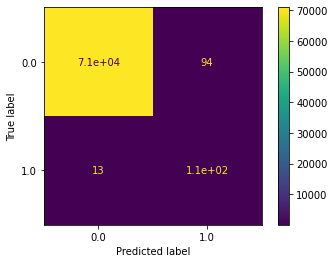

In [16]:
lgbmboost_best_hyperparams['n_estimators'] = 30000
lgbm_boost.run_with_hyperparams(lgbmboost_best_hyperparams, device = 'gpu')
lgbm_boost.metrics()

As we increase n_estimators, we see that average precision score is also increasing, but at the cost of recall score, which is more important to us. So I won't be increasing n_estimators anymore.

,Metric,Value
0,Average Precision,0.245982
1,Precision,0.277354
2,Recall,0.886179
3,Balanced Accuracy,0.941091


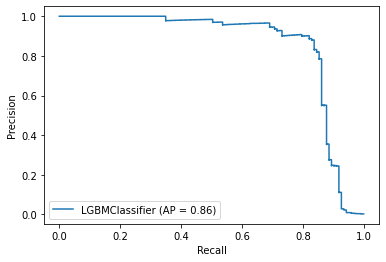

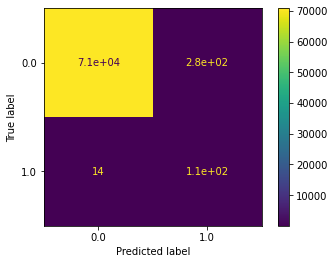

In [80]:
lgbmboost_best_hyperparams['n_estimators'] = 10000
lgbm_boost_oversampled = LGBMBoost_Model(sampled_x_train, sampled_y_train, X_test.to_numpy(), y_test.to_numpy())
lgbm_boost_oversampled.run_with_hyperparams(lgbmboost_best_hyperparams, device = 'gpu')
lgbm_boost_oversampled.metrics()

# **Neural Network with Tensorflow**

In [18]:
y_train_np = y_train.values
y_train_np = y_train_np.ravel()
class_weights = compute_class_weight('balanced', np.unique(y_train_np), y_train_np)

In [19]:
class_weights = {0: class_weights[0], 1: class_weights[1]}
class_weights

{0: 0.5008653075007387, 1: 289.4146341463415}

In [ ]:
class Sampled_Data():
  def __init__(self, x_train, y_train, over_sampling_strategy = 0.20, under_sampling_strategy = 0.9): # over_sampling started with 0.15
    self.x_train = x_train
    self.y_train = y_train
    self.oversample = SMOTE(sampling_strategy = over_sampling_strategy, k_neighbors = 6)
    #self.undersample = RandomUnderSampler(sampling_strategy = under_sampling_strategy)
    
  def sample(self):
    steps = [('over', self.oversample)] #[('over', self.oversample), ('under', self.undersample)]
    pipeline = Pipeline(steps = steps)
    return pipeline.fit_resample(self.x_train, self.y_train)

sampled_d = Sampled_Data(X_train, y_train)
sampled_x_train, sampled_y_train = sampled_d.sample()

I tried both undersampling and oversampling. Undersampling definitely helped a great deal in TP classifications, but also resulted in high #s of FPs. Removing undersampling of majority class (0 labels) gave a better balance between TPs and FPs.

In [21]:
METRICS = [
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'), 
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),
      tf.keras.metrics.AUC(name='prc', curve='PR'),
      tf.keras.metrics.BinaryCrossentropy(name='binary_crossentropy')
]

In [ ]:
class NN_Hyperparameter_Tune():
  def __init__(self, x_train, y_train, x_test, y_test, class_weights):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.class_weights = class_weights
    self.HP_NUM_UNITS_1 = hparam.HParam('num_units', hparam.Discrete([32, 64]))
    self.HP_NUM_UNITS_2 = hparam.HParam('num_units_2', hparam.Discrete([32, 64]))
    self.HP_DROPOUT = hparam.HParam('dropout', hparam.Discrete([0.05, 0.15]))
    self.HP_OPTIMIZER = hparam.HParam('optimizer', hparam.Discrete(['adam']))
    self.METRIC_ACCURACY = 'tp'
    self.model = None
    self.hparams = None

  def param_set(self):
    with tf.summary.create_file_writer('logs/hparam_tuning').as_default():
      hparam.hparams_config(
        self.hparams = [self.HP_NUM_UNITS_1, self.HP_NUM_UNITS_2, self.HP_DROPOUT, self.HP_OPTIMIZER],
        self.metrics = [hparam.Metrics(self.METRIC_ACCURACY, display_name = "TP")],
      )

  def get_callback(self):
      return [
        tfdocs.modeling.EpochDots(),
        tf.keras.callbacks.EarlyStopping(monitor='binary_crossentropy', patience=200),
      ] 

  def train_test_model(self, hparams):
    self.model = tf.keras.models.Sequential([
      tf.keras.layers.Dense(self.hparams[self.HP_NUM_UNITS_1], activation='relu', kernel_regularizer = tf.keras.regularizers.l2(0.0001)),
      tf.keras.layers.Dense(self.hparams[self.HP_NUM_UNITS_2], activation='relu', kernel_regularizer = tf.keras.regularizers.l2(0.0001)),
      tf.keras.layers.Dense(self.hparams[self.HP_NUM_UNITS_2], activation='relu', kernel_regularizer = tf.keras.regularizers.l2(0.0001)),
      tf.keras.layers.Dense(32,activation='relu'),
      tf.keras.layers.Dropout(self.hparams[self.HP_DROPOUT]),
      tf.keras.layers.Dense(1, activation='sigmoid'),
    ])

    self.model.compile(
        optimizer = self.hparams[self.HP_OPTIMIZER],
        loss = tf.keras.losses.BinaryCrossentropy(),
        metrics = METRICS
        )

    history = self.model.fit(self.x_train,
                        self.y_train,
                        epochs = 10000,
                        class_weight = self.class_weights,
                        callbacks = self.get_callbacks(),
                        batch_size = 10000,
                        verbose = 0
                        )
    metrics = self.model.evaluate(self.x_test, self.y_test)
    return history #metrics[0] 

  def run(run_dir, hparams):
    with tf.summary.create_file_writer(run_dir).as_default():
      hparam.hparams(self.hparams)  # record the values used in this trial
      with tf.device('/device:GPU:0'): 
        accuracy = self.train_test_model(hparams)

  def tune(self):
    session_num = 0

    for num_units in self.HP_NUM_UNITS_1.domain.values:
      for num_units_2 in self.HP_NUM_UNITS_2.domain.values:
        for dropout_rate in self.HP_DROPOUT.domain.values:
          for optimizer in self.HP_OPTIMIZER.domain.values:
            self.hparams = {
                HP_NUM_UNITS_1: num_units,
                HP_NUM_UNITS_2: num_units_2,
                HP_DROPOUT: dropout_rate,
                HP_OPTIMIZER: optimizer,
            }
            run_name = "run-%d" % session_num
            print('--- Starting trial: %s' % run_name)
            print({h.name: self.hparams[h] for h in self.hparams})
            run('logs/hparam_tuning/' + run_name, hparams)
            session_num += 1

#%tensorboard --logdir logs/hparam_tuning

--- Starting trial: run-0
{'num_units': 32, 'num_units_2': 32, 'dropout': 0.05, 'optimizer': 'adam'}

Epoch: 0, accuracy:0.8184,  fn:3207.0000,  fp:63110.0000,  loss:0.3993,  tn:254428.0000,  tp:44475.0000,  val_binary_crossentropy:0.3965,  
....................................................................................................
Epoch: 100, accuracy:0.9997,  fn:0.0000,  fp:65.0000,  loss:0.0062,  tn:213170.0000,  tp:31985.0000,  val_binary_crossentropy:0.0013,  
....................................................................................................
Epoch: 200, accuracy:0.9998,  fn:0.0000,  fp:37.0000,  loss:0.0036,  tn:213198.0000,  tp:31985.0000,  val_binary_crossentropy:0.0006,  
....................................................................................................
Epoch: 300, accuracy:0.9999,  fn:0.0000,  fp:16.0000,  loss:0.0026,  tn:213219.0000,  tp:31985.0000,  val_binary_crossentropy:0.0004,  
...............................................

After running hyperparam tuning for several times with different search spaces, I realized the highest accuracy it could reach was 0.9993 with approx. 0.81 recall and 0.8 precision. However, number of TPs and FNs seemed to be fixed. Since we want to decrease # of FNs as much as we can, I changed SMOLE oversampling.

## **Hyperparameter Tuning**

**Space**
  1. **Dropout Rate** — [0.05, 0.15, 0.2, 0.25]
  2. **Optimizer**s — ['adam', 'svg', 'adagrad', 'adadelta']
  3. **Layer 1, # of units** — [32, 64, 256, 512]
  4. **Layer 2, # of units** — [32, 64, 128, 256]

### **Phase 1**
Started hyperparameter tuning with Adagrad, SVG, Adam and Adadelta. After running them with diffferent hyperparameters, Adagrad and Adadelta has consistently performed worse than Adam and svg so I removed them. 

### **Phase 2**
Dropout rates in the range 0.05 - 0.15 gave the best results regardless of other hyperparameters. Specifically, it predicted smaller number of false positives with similar amount of true positives compared to rates in the range 0.2-0.25. Adam was better than SVG in TP-FP balance. SVG had approximately 0.33 precision whereas Adam had 0.55.

### **Phase 3**

### **Phase 4**
As the number of units increased, precision rates of both Adam and SVG dropped while recall rates increased by miniscule amounts. For example, n test data, FN dropped to 22 from 23 using Adam and 64 units. For the sake of model simplicity, I decided to use 32 number of units for the second layer. 

In [ ]:
class NN_Model():
  def __init__(self, x_train, y_train, x_test, y_test, class_weights):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.class_weights = class_weights
    self.metrics = [
          tf.keras.metrics.TruePositives(name='tp'),
          tf.keras.metrics.FalsePositives(name='fp'),
          tf.keras.metrics.TrueNegatives(name='tn'),
          tf.keras.metrics.FalseNegatives(name='fn'), 
          tf.keras.metrics.BinaryAccuracy(name='accuracy'),
          tf.keras.metrics.Precision(name='precision'),
          tf.keras.metrics.Recall(name='recall'),
          tf.keras.metrics.AUC(name='prc', curve='PR'),
          tf.keras.metrics.BinaryCrossentropy(name='val_binary_crossentropy')
    ]
    self.model = None

  def get_callbacks(self):
    return [
      tfdocs.modeling.EpochDots(),
      tf.keras.callbacks.EarlyStopping(monitor='val_binary_crossentropy', patience=200),
    ]


  def train_test_model_res(self):
    self.model = tf.keras.models.Sequential([
      tf.keras.layers.Dense(64, activation='relu', kernel_regularizer = tf.keras.regularizers.l2(0.01)),
      tf.keras.layers.Dense(32, activation='relu', kernel_regularizer = tf.keras.regularizers.l2(0.01)),
      tf.keras.layers.Dense(32, activation='relu', kernel_regularizer = tf.keras.regularizers.l2(0.01)),
      tf.keras.layers.Dense(32, activation='relu'),
      tf.keras.layers.Dropout(0.05),
      tf.keras.layers.Dense(1, activation='sigmoid'),
    ])

    self.model.compile(
        optimizer='adam',
        loss = 'binary_crossentropy',
        weighted_metrics = self.metrics
        )

    self.model.fit(self.x_train, 
              self.y_train,
              epochs = 10000,
              batch_size = 5000,
              class_weight = self.class_weights,
              callbacks = self.get_callbacks(),
              verbose = 0) 
    preds = self.model.evaluate(self.x_test, self.y_test, return_dict=True)
    return preds

In [ ]:
with tf.device('/device:GPU:0'): 
  nn_model = NN_Model(sampled_x_train, sampled_y_train, X_test, y_test, class_weights)
  pred = nn_model.train_test_model_res()

In [ ]:
tf_nn_metrics = pd.DataFrame.from_dict(pred, orient='index', columns = ['Values'])
tf_nn_metrics

,Values
tp,102.000000
fp,27.000000
tn,71046.000000
fn,21.000000
accuracy,0.999326
precision,0.790698
recall,0.829268
prc,0.775030


We see that the neural network model resulted in a much better balance between precision and recall. We only make 24 FN classifications as opposed to 90+ in LightGBM model.

In [ ]:
class DNN():
  def __init__(self, x_train, y_train, x_test, y_test):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.input_func = None
    self.test_input_func = None
    self.eval_input_func = None
    self.tf_features = []
    self.model = None
    self.metrics = []
    self.predictions = []

  def AUC(self, labels, predictions):
    auc_metric = tf.keras.metrics.AUC(name="prc", curve='PR')
    auc_metric.update_state(y_true=labels, y_pred=predictions['logistic'])
    return {'auc': auc_metric}

  def run_model(self):
    self.model = tf.estimator.DNNClassifier(
        feature_columns = self.tf_features,
        hidden_units = [64, 32, 32, 16],
        optimizer=lambda: tf.keras.optimizers.Adam(
        learning_rate=tf.compat.v1.train.exponential_decay(
            learning_rate=0.01,
            global_step=tf.compat.v1.train.get_global_step(),
            decay_steps=200,
            decay_rate=0.25 )),
        dropout = 0.15
    )
    self.model = tf.estimator.add_metrics(self.model, self.AUC)
    self.model.train(input_fn = lambda: self.input_fn(self.x_train, self.y_train, training=True), steps=10000)
    plt.plot(self.model.history['accuracy'], label='train')
    self.predictions = self.model.evaluate(input_fn = lambda: self.input_fn(self.x_test, self.y_test, training=False))
    print('\nTest set accuracy: {accuracy:0.3f}\n'.format(**self.predictions))

  def input_fn(self, features, labels, training=True, batch_size=10000):
    dataset = tf.data.Dataset.from_tensor_slices((dict(features), labels))
    if training:
        dataset = dataset.shuffle(10000).repeat()
    return dataset.batch(batch_size)

  def process_data(self):
    for col_name in self.x_train.columns:
      self.tf_features.append(tf.feature_column.numeric_column(col_name))


In [ ]:
dnn_model = DNN(X_train, y_train, X_test, y_test)
dnn_model.process_data()
dnn_model.run_model()

## Tensorflow Decision Forest

In [23]:
y_test_i = y_test.set_index(X_test.index)

In [24]:
sampled_x_train_df = pd.DataFrame(sampled_x_train, columns=X_train.columns)
sampled_x_train_df['Class'] = sampled_y_train

x_test_df = X_test.copy()
x_test_df['Class'] = y_test_i
sampled_x_train_df 

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.808412,0.040681,0.282524,-0.420954,-0.307166,1.033522,-0.686746,1.262727,-0.365916,-0.212739,-0.100900,0.107518,-0.396345,-1.977328,0.979000,-0.960379,-0.990619,-0.475294,0.462425,1.058557,-0.124863,0.392426,1.384339,-0.386672,-0.757891,-0.898160,-0.380906,0.057821,-0.025528,-0.246441,0.0
1,1.435336,1.202588,-0.738873,-1.004734,-1.251309,-0.616614,-0.719866,-0.624901,-0.187226,-1.634726,1.731319,0.478897,-0.920651,-0.901008,0.464400,-0.444472,-0.414805,0.262212,0.283879,0.321079,-0.719254,-0.414345,-0.692318,0.458276,-0.787727,-0.420971,-0.625943,-0.072725,-0.237778,-0.355778,0.0
2,0.565625,-0.527353,0.905134,-0.212025,0.658603,0.117594,-0.517775,0.273436,-0.550707,-0.351563,0.198508,-1.082129,-0.189757,-0.308418,0.834260,0.853857,-0.437730,-0.057298,0.383373,0.276636,-0.459484,1.641567,1.396547,-0.264021,-0.007557,-0.937106,-0.781449,0.519031,0.564687,-0.243503,0.0
3,-0.976499,-0.619699,0.439777,1.278212,0.622138,-0.193231,1.137346,0.146389,0.031370,0.449035,0.647177,0.323725,-0.370832,-1.180246,-0.309428,0.868708,-0.125743,-0.463518,1.062595,1.176257,-0.277541,0.288376,1.080207,-0.732631,-1.331169,-0.343064,-0.320370,-1.842714,-0.217484,-0.003003,0.0
4,-1.236287,-0.372087,0.480503,1.129710,-0.067866,0.539311,-0.293590,0.486861,0.011191,-0.382166,-0.667431,-1.208409,0.020810,0.704528,-0.067638,0.618253,0.813635,-1.307336,0.144328,-0.642488,-0.008903,-0.187260,-0.710686,-0.266152,-0.807518,0.118313,-1.486566,0.250409,0.372973,-0.347174,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255857,-0.628895,0.406675,0.456799,-2.201482,1.664309,-1.733156,-0.446963,-2.630351,0.993311,0.049524,-2.596108,3.027493,-2.560499,-0.954737,-3.710270,1.117793,-4.604952,-5.061926,-1.156938,3.307713,0.434274,1.230394,1.907043,1.053129,0.462914,-2.650240,-0.815059,1.040944,-0.169346,-0.100075,1.0
255858,-1.209031,0.125634,0.672038,-0.055406,1.209024,0.660619,-0.118665,0.347629,0.121960,-0.856202,-0.432821,1.606586,-0.278381,-0.956661,-1.528641,0.686737,0.887860,1.517719,1.236967,-0.539714,-0.113560,-0.051357,-0.179526,-0.243372,-0.840243,0.705788,-0.207821,-0.081565,0.109747,-0.358732,1.0
255859,1.132303,-0.569792,1.403149,-4.092514,1.404973,-0.584411,-1.187515,-2.954298,1.240516,-1.719805,-5.787716,3.804415,-5.415116,-0.674483,-8.480254,0.451714,-4.956582,-7.048586,-2.546460,0.093592,0.467580,1.403413,0.884767,-0.605137,-2.108453,0.240831,0.305259,1.625392,1.063255,-0.068039,1.0
255860,1.029294,0.609497,1.831828,-3.923747,3.878626,1.159216,-1.260844,-0.822745,0.261792,-2.760330,-3.356211,4.338844,-4.247697,-0.897783,-10.015966,-0.824421,0.262350,-0.328766,1.450434,-2.067112,0.386186,0.225764,-0.988821,-0.138266,0.100164,0.787097,0.185937,1.192509,0.977891,-0.362506,1.0


In [25]:
df_train_ds = tfdf.keras.pd_dataframe_to_tf_dataset(sampled_x_train_df, label="Class", fix_feature_names=True)
df_test_ds = tfdf.keras.pd_dataframe_to_tf_dataset(x_test_df, label="Class", fix_feature_names=True)

### Random Forest Model

In [ ]:
model_rft = tfdf.keras.RandomForestModel()

model_rft.compile(
    metrics = METRICS
    )

model_rft.fit(x = df_train_ds)

In [ ]:
tfdf.model_plotter.plot_model_in_colab(model_rft, tree_idx=0, max_depth=4)

We can see that our assumptions from feature engineering section hold.

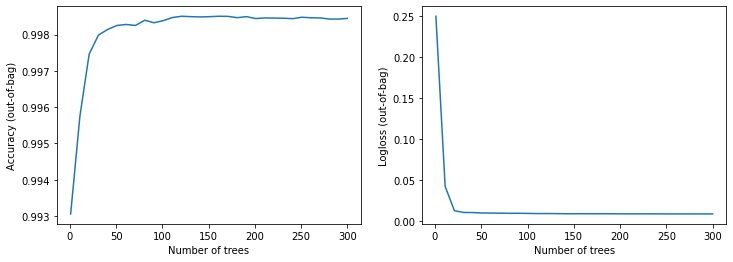

In [ ]:
logs = model_rft.make_inspector().training_logs()

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot([log.num_trees for log in logs], [log.evaluation.accuracy for log in logs])
plt.xlabel("Number of trees")
plt.ylabel("Accuracy (out-of-bag)")

plt.subplot(1, 2, 2)
plt.plot([log.num_trees for log in logs], [log.evaluation.loss for log in logs])
plt.xlabel("Number of trees")
plt.ylabel("Logloss (out-of-bag)")

plt.show()

In [ ]:
evaluation = model_rft.evaluate(df_test_ds, return_dict=True)

In [ ]:
tf_rft_metrics = pd.DataFrame.from_dict(evaluation, orient='index', columns = ['Values'])
tf_rft_metrics

,Values
tp,105.000000
fp,22.000000
tn,71051.000000
fn,18.000000
accuracy,0.999438
precision,0.826772
recall,0.853659
prc,0.877944


A simple Random Decision Forest model resulted in even better accuracy than Neural Network. 

### Gradient Boosting Tree + Neural Network




In [ ]:
model_gbt = tfdf.keras.GradientBoostedTreesModel(
    num_trees=800,
    growing_strategy="BEST_FIRST_GLOBAL",
    max_depth=21,
    categorical_algorithm = "CART",
    forest_extraction = "DART"
    )

model_gbt.compile(
    metrics = METRICS
    )

model_gbt.fit(x = df_train_ds)

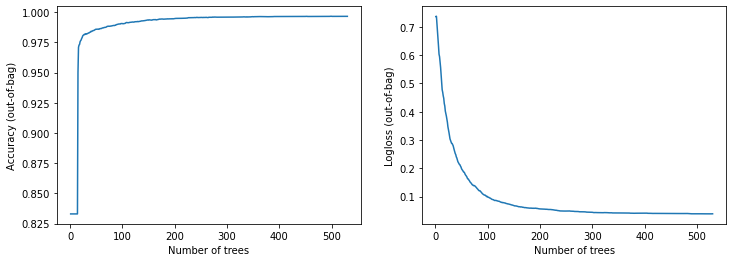

In [ ]:
logs = model_gbt.make_inspector().training_logs()

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot([log.num_trees for log in logs], [log.evaluation.accuracy for log in logs])
plt.xlabel("Number of trees")
plt.ylabel("Accuracy (out-of-bag)")

plt.subplot(1, 2, 2)
plt.plot([log.num_trees for log in logs], [log.evaluation.loss for log in logs])
plt.xlabel("Number of trees")
plt.ylabel("Logloss (out-of-bag)")

plt.show()

In [ ]:
tfdf.model_plotter.plot_model_in_colab(model_gbt, tree_idx=0, max_depth=4)

In [ ]:
evaluation_gbt_1 = model_gbt.evaluate(df_test_ds, return_dict=True)

In [ ]:
tf_gbt_metrics = pd.DataFrame.from_dict(evaluation_gbt_1, orient='index', columns = ["Values"])
tf_gbt_metrics

,Values
tp,108.000000
fp,27.000000
tn,71046.000000
fn,15.000000
accuracy,0.999410
precision,0.800000
recall,0.878049
prc,0.877771


In [ ]:
class GBTree_NN_Model():
  def __init__(self, train_ds, test_ds, class_weights):
    self.train_ds = train_ds
    self.test_ds = test_ds
    self.nn_model = None
    self.gbt_nn_model = None
    self.gbt_model = None
    self.CART_model = None
    self.class_weights = class_weights
    self.preds = None
    self.metrics = [
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'), 
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),
      tf.keras.metrics.AUC(name='prc', curve='PR'),
      tf.keras.metrics.BinaryCrossentropy(name='binary_crossentropy')
    ]

  def get_callbacks(self):
    return [
      tfdocs.modeling.EpochDots(),
      tf.keras.callbacks.EarlyStopping(monitor='binary_crossentropy', patience=150),
    ]

  def process_data(self):
    input_1 = tf.keras.Input(shape=(1,), name="Time")
    input_30 = tf.keras.Input(shape=(1,), name="Amount")
    self.inputs = [input_1, input_30]
    for i in range(1, 29):
      nm = "V" + str(i)
      self.inputs.append(tf.keras.Input(shape=(1,), name = nm))

  def make_model(self):
    inputs = tf.keras.layers.Concatenate()(self.inputs)
    layer = tf.keras.layers.Dense(64, activation = tf.nn.relu6, kernel_regularizer = tf.keras.regularizers.l2(0.01))(inputs)
    layer = tf.keras.layers.Dense(32, activation = tf.nn.relu6, kernel_regularizer = tf.keras.regularizers.l2(0.01))(layer)
    layer = tf.keras.layers.Dropout(0.1)(layer)
    # The outputs of last_layer will be fed into the tree
    last_layer = tf.keras.layers.Dense(32, activation = tf.nn.relu, name="last")(layer)
    classification_output = tf.keras.layers.Dense(1, activation="sigmoid")(layer)

    self.nn_model = tf.keras.models.Model(self.inputs, classification_output)
    nn_without_head = tf.keras.models.Model(inputs = self.nn_model.inputs, outputs = last_layer)

    # NN + Gradient Boosted Tree
    self.gbt_nn_model = tfdf.keras.GradientBoostedTreesModel(
        preprocessing = nn_without_head,
        num_trees = 1600,
        growing_strategy = "BEST_FIRST_GLOBAL",
        max_depth = 21,
        categorical_algorithm = "CART",
        forest_extraction = "DART"
    )

    # NN + CART
    self.CART_model = tfdf.keras.CartModel(
        preprocessing = nn_without_head,
        max_depth = 21,
    )

  def compile_and_run(self):
    self.nn_model.compile(
          optimizer = tf.keras.optimizers.Adam(learning_rate=0.001),
          loss = tf.keras.losses.BinaryCrossentropy(),
          weighted_metrics = self.metrics
    )

    self.nn_model.fit(x = self.train_ds, 
                      validation_data = self.test_ds,
                      epochs = 10,
                      class_weight = self.class_weights,
                      callbacks=self.get_callbacks(),
                      verbose = 0
    )

    self.gbt_nn_model.compile(metrics = self.metrics)
    self.gbt_nn_model.fit(self.train_ds)

    self.CART_model.compile(metrics = self.metrics)
    self.CART_model.fit(self.df_train_ds)

In [ ]:
with tf.device('/device:GPU:0'): 
  gbt_nn_m = GBTree_NN_Model(df_train_ds, df_test_ds, class_weights)
  gbt_nn_m.process_data()
  gbt_nn_m.make_model()
  gbt_nn_m.compile_and_run()

In [ ]:
gbt_nn_preds = gbt_nn_m.gbt_nn_model.evaluate(df_test_ds, return_dict=True)
tf_gbt_nn_metrics = pd.DataFrame.from_dict(gbt_nn_preds, orient='index')
tf_gbt_nn_metrics

1113/1113 [==============================] - 10s 8ms/step - loss: 0.0076 - tp: 107.0000 - fp: 258.0000 - tn: 70815.0000 - fn: 16.0000 - accuracy: 0.9962 - precision: 0.2932 - recall: 0.8699 - prc: 0.6984 - binary_crossentropy: 0.0312


,0
tp,107.000000
fp,258.000000
tn,70815.000000
fn,16.000000
accuracy,0.996151
precision,0.293151
recall,0.869919
prc,0.698449


In [ ]:
cart_nn_preds = gbt_nn_m.CART_model.evaluate(df_test_ds, return_dict=True)
tf_cart_metrics = pd.DataFrame.from_dict(cart_nn_preds, orient='index')
tf_cart_metrics

1113/1113 [==============================] - 10s 8ms/step - loss: 0.0076 - tp: 112.0000 - fp: 543.0000 - tn: 70530.0000 - fn: 11.0000 - accuracy: 0.9922 - precision: 0.1710 - recall: 0.9106 - prc: 0.5591 - binary_crossentropy: 0.0365


,0
loss,0.007638
tp,112.000000
fp,543.000000
tn,70530.000000
fn,11.000000
accuracy,0.992219
precision,0.170992
recall,0.910569
prc,0.559072
binary_crossentropy,0.036455


## CATBoost

In [65]:
class CatBoost_Model():
  def __init__(self, x_train, y_train, x_test, y_test, class_weights, learning_rate):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.model = CatBoostClassifier(
        iterations = 10000,
        learning_rate = learning_rate,
        task_type='GPU',
        #class_weights = class_weights,
        loss_function = 'Logloss', # CrossEntropy
        early_stopping_rounds = 200,
        eval_metric = 'Logloss',
        #auto_class_weights = 'Balanced',
        #l2_leaf_reg = 0.01,
        #depth = 11
    )

  def fit_run_model(self):  
    self.model.fit(
        self.x_train, self.y_train,
        eval_set=(self.x_test, self.y_test),
        verbose = 0,
        plot = True,
        use_best_model=True,
    ); 

    self.predictions = self.model.predict(self.x_test)
    return self.metrics()

  def metrics(self):
    average_precision = average_precision_score(self.y_test, self.predictions)
    balanced_accuracy = balanced_accuracy_score(self.y_test, self.predictions)
    precision = precision_score(self.y_test, self.predictions)
    recall = recall_score(self.y_test, self.predictions)
    plot_precision_recall_curve(self.model, self.x_test, self.y_test)
    plot_confusion_matrix(self.model, self.x_test, self.y_test)  
    lc_metrics_list_normal = [['Average Precision', average_precision], ['Precision', precision], ['Recall', recall], ['Balanced Accuracy', balanced_accuracy]]
        
    lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
    return lc_metrics_df_normal

#### CatBoost without Oversampling (no hyperparameter tuning)

,Metric,Value
0,Average Precision,0.797390
1,Precision,0.980392
2,Recall,0.813008
3,Balanced Accuracy,0.906490


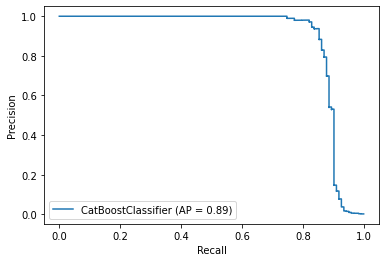

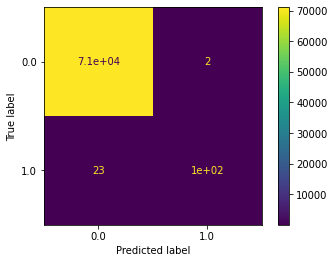

In [66]:
catboost = CatBoost_Model(X_train, y_train, X_test, y_test, class_weights, 0.01)
catboost.fit_run_model()

#### CatBoost with Oversampling (no hyperparameter tuning)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

,Metric,Value
0,Average Precision,0.713108
1,Precision,0.851240
2,Recall,0.837398
3,Balanced Accuracy,0.918573


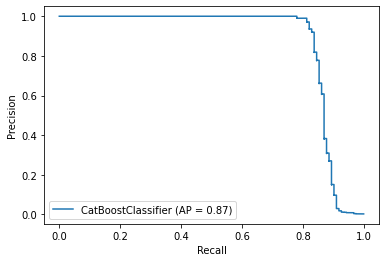

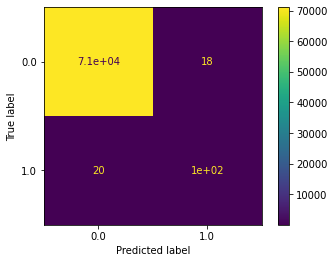

In [67]:
catboost_oversampled = CatBoost_Model(sampled_x_train, sampled_y_train, X_test, y_test, class_weights, 0.01)
catboost_oversampled.fit_run_model()

In [53]:
class CatBoost_Model_Hyperopt():
  def __init__(self, x_train, y_train, x_test, y_test):
    self.x_train = x_train
    self.y_train = y_train
    self.x_test = x_test
    self.y_test = y_test
    self.best_params = {}
    self.predictions = None
    self.model = None

  def get_bestparams(self):
    return self.best_hyperparams

  def objective(self, space):
    self.model = CatBoostClassifier(
        iterations = 10000,
        learning_rate = space['learning_rate'],
        max_depth = int(space['max_depth']),
        task_type='GPU',
        loss_function = 'CrossEntropy', # CrossEntropy
        early_stopping_rounds = 200,
        eval_metric = 'CrossEntropy',
        reg_lambda = space['reg_lambda']
    )

    self.model.fit(
        self.x_train, self.y_train,
        eval_set=(self.x_test, self.y_test),
        verbose = 100,
        plot = True,
        use_best_model=True,
    ); 
    
    pred = self.model.predict(self.x_test)
    accuracy = balanced_accuracy_score(self.y_test, pred)
    return {'loss': -accuracy, 'status': STATUS_OK }

  def hyperparam_search(self, 
                        max_depth = hp.quniform("max_depth", 6, 13, 1), 
                        reg_lambda = hp.uniform('reg_lambda', 0, 0.5),
                        learning_rate = hp.uniform('learning_rate', 0.009, 0.1),
                        seed = 0
                        ):
    
    space = {'max_depth': max_depth, 'reg_lambda': reg_lambda,
             'learning_rate': learning_rate,
             'seed': seed }

    trials = Trials()
    self.best_hyperparams = fmin(fn = self.objective, space = space, algo = tpe.suggest, max_evals = 100, trials = trials)

  def run_with_hyperparams(self, best_hyperparams):
    self.model = CatBoostClassifier(
        iterations = 10000,
        learning_rate = best_hyperparams['learning_rate'],
        max_depth = int(best_hyperparams['max_depth']),
        task_type='GPU',
        loss_function = 'Logloss', # CrossEntropy
        early_stopping_rounds = 200,
        eval_metric = 'Logloss',
        reg_lambda = best_hyperparams['reg_lambda']
    )

    self.model.fit(
        self.x_train, self.y_train,
        eval_set=(self.x_test, self.y_test),
        verbose = 0,
        plot = True,
        use_best_model=True,
    ); 
    
    self.predictions = self.model.predict(self.x_test)
    return self.metrics()

  def metrics(self):
    average_precision = average_precision_score(self.y_test, self.predictions)
    balanced_accuracy = balanced_accuracy_score(self.y_test, self.predictions)
    precision = precision_score(self.y_test, self.predictions)
    recall = recall_score(self.y_test, self.predictions)
    plot_precision_recall_curve(self.model, self.x_test, self.y_test)
    plot_confusion_matrix(self.model, self.x_test, self.y_test)  
    lc_metrics_list_normal = [['Average Precision', average_precision], ['Precision', precision], ['Recall', recall], ['Balanced Accuracy', balanced_accuracy]]
        
    lc_metrics_df_normal = pd.DataFrame(lc_metrics_list_normal, columns = ['Metric', 'Value'])
    return lc_metrics_df_normal

#### CatBoost with Oversampling and Hyperparameter Tuning

In [68]:
catboost_hyperopt = CatBoost_Model_Hyperopt(sampled_x_train, sampled_y_train, X_test.to_numpy(), y_test.to_numpy())
#catboost_hyperopt.hyperparam_search()
#catboost_hyperopt.run_with_hyperparams()

In [50]:
catboost_bestparams = {'learning_rate': 0.03793968183391376,
                      'max_depth': 11.0,
                      'reg_lambda': 0.20504643265140218
                       }

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5804756	test: 0.5812903	best: 0.5812903 (0)	total: 42.3ms	remaining: 7m 3s
100:	learn: 0.0043250	test: 0.0039918	best: 0.0039918 (100)	total: 3.74s	remaining: 6m 6s
200:	learn: 0.0010917	test: 0.0029159	best: 0.0029159 (200)	total: 7.3s	remaining: 5m 55s
300:	learn: 0.0004049	test: 0.0028072	best: 0.0028007 (288)	total: 10.9s	remaining: 5m 49s
400:	learn: 0.0001975	test: 0.0028813	best: 0.0028007 (288)	total: 14.4s	remaining: 5m 45s
bestTest = 0.00280070191
bestIteration = 288
Shrink model to first 289 iterations.


,Metric,Value
0,Average Precision,0.742918
1,Precision,0.861789
2,Recall,0.861789
3,Balanced Accuracy,0.930775


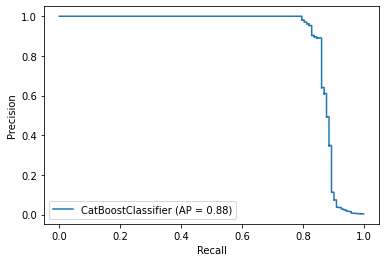

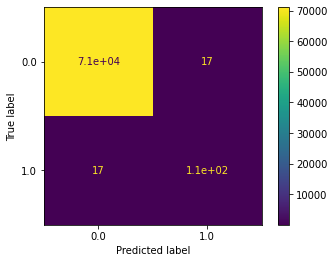

In [69]:
catboost_hyperopt.run_with_hyperparams(catboost_bestparams)

#### CatBoost without Oversampling (with hyperparameter tuning)

bestTest = 0.002198644994
bestIteration = 95
Shrink model to first 96 iterations.


,Metric,Value
0,Average Precision,0.813616
1,Precision,0.980769
2,Recall,0.829268
3,Balanced Accuracy,0.914620


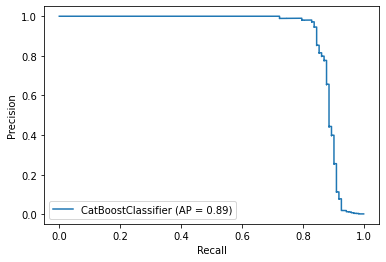

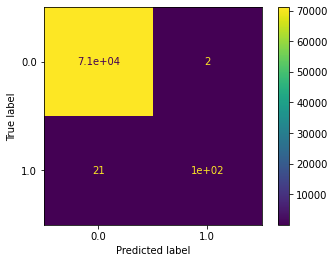

In [71]:
catboost_hyperopt = CatBoost_Model_Hyperopt(X_train, y_train, X_test, y_test)
catboost_hyperopt.run_with_hyperparams(catboost_bestparams)

# Conclusion

TF Gradient Boosting model has returned the best results with balanced Recall - Precision scores.

In [79]:
res_metrics = pd.DataFrame(res_rows, columns = ['Model','Precision', 'Recall', 'Balanced Accuracy'])
res_metrics = res_metrics.sort_values(by=['Recall'], ascending=False)
res_metrics

,Model,Precision,Recall,Balanced Accuracy
8,LG Normal 400,0.08,0.92,0.955
16,NN + CART,0.17,0.91,NA
1,Normal Logistics,0.06,0.91,0.94
9,LG Normal 2000,0.14,0.91,0.95
0,PCA Logistics,0.02,0.89,0.91
10,LG Normal 10000,0.49,0.89,0.94
11,LG Normal 30000,0.53,0.89,0.94
6,XGBoost Oversampled,0.36,0.88,0.94
14,TF GBT,0.80,0.87,NA
15,NN + GBT,0.29,0.87,NA


**Note that false negatives in this scenario is much worse than false positives. Having a hold on our credit card is a minor inconvenience, whereas not having it in the case of fraud can be devastating. With this in mind, we look for a model with a high recall score.**

Although LightGBM and NN + Cart have the two highest recall scores, their precisions are terrible. Even though we do want to favor TNs, we still want a respectable precision (otherwise we might as well classify all transactions as fraudulent). We see that 'CatBoost Oversampled w HTuning' has the best balance between precision and recall.